## Jordi Blasco Lozano  
### Visualización de Imágenes y Keypoints – Parte 2

- #### PYTHONPATH para el DataLoader

In [ ]:
import sys
import os

# Agrega el directorio padre (la raíz del proyecto) al sys.path
sys.path.append(os.path.abspath('..'))

- #### Librerías y Configuración Inicial

    En este bloque se importan las librerías necesarias para la visualización.

    También se importa el módulo **DataLoader** para cargar nuestro dataset de paths.

In [ ]:

import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import scipy.io as sio
import pandas as pd

# Importar DataLoader del proyecto.
from data.dataloader import DataLoader

- #### Carga del Dataset

    A continuación, se instancia la clase **DataLoader** para cargar los datos.
    El DataFrame resultante contiene todas las rutas de las imágenes y los archivos que contienen los keypoints, permitiendo acceder a la información de cada categoría. Nos guardamos en este caso también las categorias para mostrarlas en los titulos de los plots

In [ ]:
# Instanciar el DataLoader y cargar los dataframes
dl = DataLoader()
dfs = dl.load_data()

# Lista de categorías a procesar
categories = ['car', 'face', 'duck', 'motorbike', 'winebottle']

- #### Redimensionamiento de Imágenes y Ajuste de Keypoints y Plotteo de Imagenes con su Grafo y Aristas Calculadas


In [ ]:
# Tamaño objetivo para redimensionar las imágenes
obj_resize = (256, 256)

def load_img_and_keypoints_from_row(row):
    """
    Carga la imagen y sus keypoints a partir de una fila del dataframe.
    """
    img_path = row['img']
    mat_path = row['mat']
    
    # Cargar la imagen
    img = Image.open(img_path)
    # Cargar el archivo .mat que contiene los keypoints
    mat_data = sio.loadmat(mat_path)
    kpts = np.array(mat_data['pts_coord']) 
    
    # Determinar el tamaño original de la imagen
    orig_size = img.size  # (ancho, alto)
    
    # Escalar los keypoints al nuevo tamaño
    kpts[0] = kpts[0] * obj_resize[0] / orig_size[0]
    kpts[1] = kpts[1] * obj_resize[1] / orig_size[1]
    
    # Redimensionar la imagen
    img_resized = img.resize(obj_resize, resample=Image.BILINEAR)
    
    return img_resized, kpts

def plot_image_with_graph(ax, img, kpts, edges, title=""):
    """
    Dibuja en el eje indicado la imagen con keypoints y el grafo sobrepuesto.
    
    Parámetros:
        - ax: objeto matplotlib.axes donde se dibuja.
        - img: imagen a mostrar.
        - kpts: array de keypoints (2, N).
        - edges: lista de tuplas (i, j) con las conexiones del grafo.
        - title: título para la subfigura.
    """
    ax.imshow(img)
    ax.scatter(kpts[0], kpts[1], c='w', edgecolors='k')
    for i, j in edges:
        ax.plot([kpts[0, i], kpts[0, j]], [kpts[1, i], kpts[1, j]], 'r-')
    ax.set_title(title)
    ax.axis('off')

- #### Construcción del Grafo usando Delaunay Triangulation 

Si temenos un grafo y conectar estos puntos formando triángulos podemos usar la **`Delaunay Triangulation`**. La idea principal de la triangulación de Delaunay es la siguiente:

1. **Conectar los puntos para formar triángulos:** Se prueban todas las posibles combinaciones de 3 puntos para ver si pueden formar un triángulo.

2. **Dibujar el círculo que pasa por los 3 vértices:** A cada triángulo se le puede dibujar un círculo (llamado "círculo circunscrito") que toque exactamente sus 3 vértices.

3. **Verificar la propiedad del círculo vacío:** La clave es asegurarse de que, para cada triángulo, no exista ningún otro punto dentro de ese círculo. Si hay algún punto dentro, ese triángulo no cumple la condición de Delaunay y se descarta.

4. **Formar el grafo:** Una vez que se han identificado todos los triángulos “válidos” (aquellos cuyo círculo circunscrito está vacío), se extraen las aristas únicas de estos triángulos para crear un grafo que conecta los puntos.



In [ ]:
def delaunay_graph(kpts):
    """
    Construye un grafo usando Delaunay triangulation.
    
    Parámetros:
        - kpts: np.array de shape (2, N) con las coordenadas de los keypoints.
        ejemplo:
    
    Devuelve:
        - edges: Lista de tuplas (i, j) representando las aristas del grafo.
    """
    pts = kpts.T  # Convertir a shape (N, 2)
    n = len(pts)
    triangles = []
    
    # Iterar sobre todas las combinaciones de 3 puntos
    for i in range(n - 2):
        for j in range(i + 1, n - 1):
            for k in range(j + 1, n):
                xi, yi = pts[i]
                xj, yj = pts[j]
                xk, yk = pts[k]
                # Calcular determinante para verificar si los puntos son colineales
                d = 2 * (xi * (yj - yk) + xj * (yk - yi) + xk * (yi - yj))
                if abs(d) < 1e-6:
                    continue  # Triángulo degenerado
                    
                # Calcular el centro del círculo circunscrito
                xc = ((xi**2 + yi**2) * (yj - yk) +
                      (xj**2 + yj**2) * (yk - yi) +
                      (xk**2 + yk**2) * (yi - yj)) / d
                yc = ((xi**2 + yi**2) * (xk - xj) +
                      (xj**2 + yj**2) * (xi - xk) +
                      (xk**2 + yk**2) * (xj - xi)) / d
                center = np.array([xc, yc])
                radius = np.linalg.norm(pts[i] - center)
                
                valid = True
                # Verificar la propiedad de círculo vacío para todos los otros puntos
                for m in range(n):
                    if m == i or m == j or m == k:
                        continue
                    if np.linalg.norm(pts[m] - center) < radius - 1e-6:
                        valid = False
                        break
                if valid:
                    triangles.append((i, j, k))
    
    # Extraer las aristas únicas de los triángulos válidos
    edges = set()
    for tri in triangles:
        for a, b in [(tri[0], tri[1]), (tri[0], tri[2]), (tri[1], tri[2])]:
            edges.add(tuple(sorted((a, b))))
    
    return list(edges)

- #### Construcción del Grafo usando k-Nearest Neighbors (k-NN)

Esta función `knn_graph()` conecta cada punto con sus k vecinos más cercanos de la siguiente forma:

1. **Calcular las distancias:**  
   Para cada punto, se calcula la distancia a todos los otros puntos del conjunto.

2. **Exclusión del mismo punto:**  
   Se ignora la distancia del punto consigo mismo (se marca como infinito).

3. **Seleccionar los k vecinos más cercanos:**  
   Se ordenan las distancias y se eligen los índices de los k puntos más cercanos.

4. **Formar las aristas del grafo:**  
   Se crean conexiones (aristas) entre el punto actual y cada uno de sus vecinos, asegurando que la conexión sea única.


In [ ]:

def knn_graph(kpts, k):
    """
    Construye un grafo usando k-Nearest Neighbors (sin distance_matrix).
    
    Parámetros:
        - kpts: np.array de shape (2, N) con las coordenadas de los keypoints.
        - k: número de vecinos a conectar.
    
    Devuelve:
        - edges: Lista de tuplas (i, j) representando las conexiones entre keypoints.
    """
    import numpy as np
    pts = kpts.T  # Convertir a shape (N, 2)
    n = len(pts)
    edges = set()
    
    # Calcular las distancias manualmente para cada punto
    for i in range(n):
        # 1. Calcular la distancia de pts[i] a todos los demás puntos
        distances = np.sqrt(np.sum((pts - pts[i])**2, axis=1))
        # 2. Excluir la distancia consigo mismo
        distances[i] = np.inf
        # 3. Obtener los índices de los k vecinos más cercanos
        knn_indices = np.argsort(distances)[:k]
        # 4. Formar las aristas del grafo con cada vecino seleccionado
        for j in knn_indices:
            edge = tuple(sorted((i, j)))
            edges.add(edge)
            
    return list(edges)

- #### Ejercicios

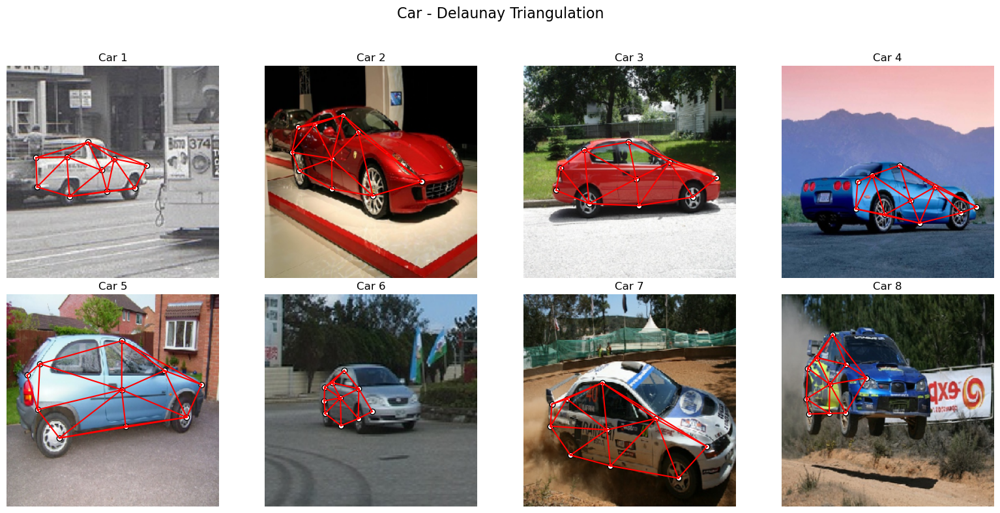

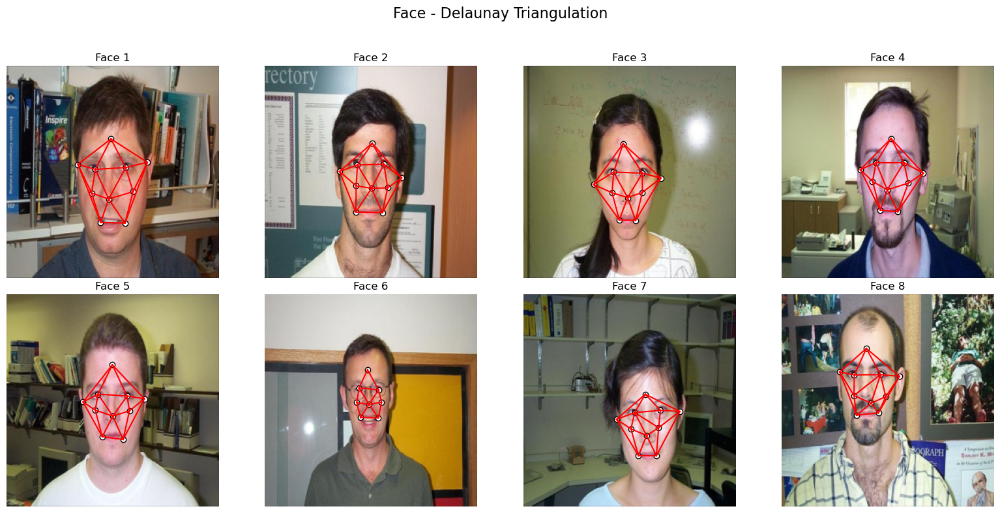

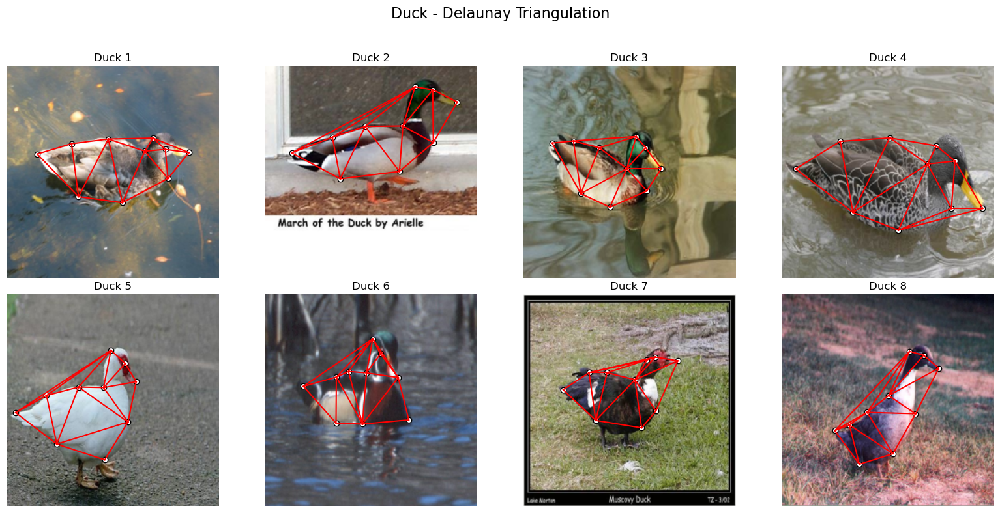

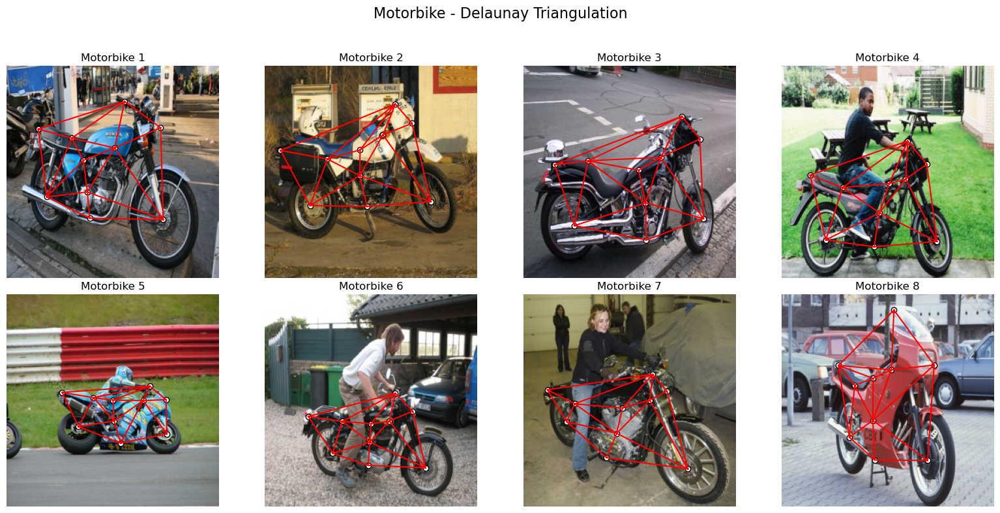

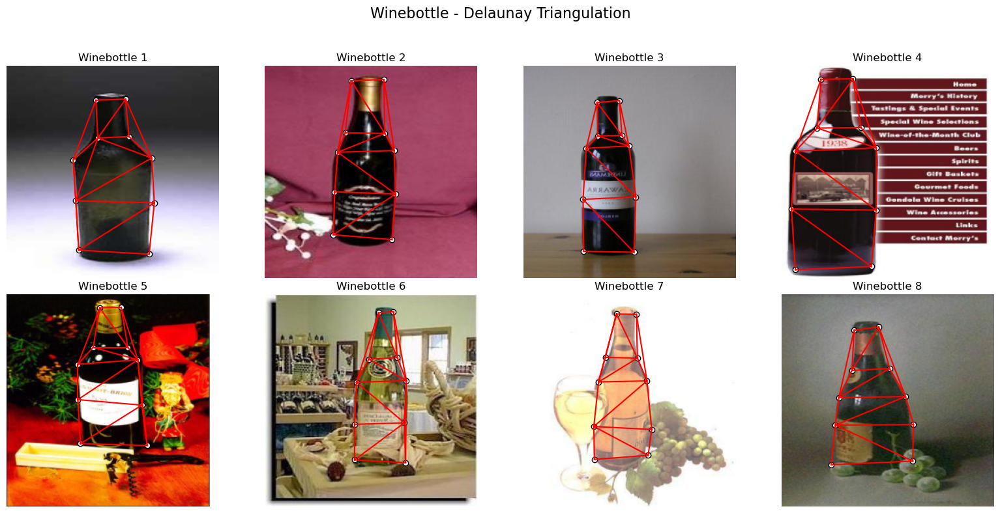

In [ ]:
# Ejercicio 1: Delaunay Triangulation
# Para cada categoría se seleccionan 8 imágenes y se muestran en un grid 2x4.

for cat in categories:
    key = f"{cat}_df"
    df_cat = dfs.get(key)
    
    # seleccion 8 imágenes
    sample_rows = df_cat.sample(8) 
    
    # Crear grid 2x4
    ncols = 4
    nrows = (len(sample_rows) + ncols - 1) // ncols
    fig, axs = plt.subplots(nrows, ncols, figsize=(16, 8))
    axs = axs.flatten()
    
    for i, (_, row) in enumerate(sample_rows.iterrows()):
        img, kpts = load_img_and_keypoints_from_row(row)
        edges = delaunay_graph(kpts)
        plot_image_with_graph(axs[i], img, kpts, edges, title=f"{cat.capitalize()} {i+1}")
    
    # Apagar ejes sobrantes en caso de haberlos
    for ax in axs[len(sample_rows):]:
        ax.axis('off')
    
    fig.suptitle(f"{cat.capitalize()} - Delaunay Triangulation", fontsize=16)
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()

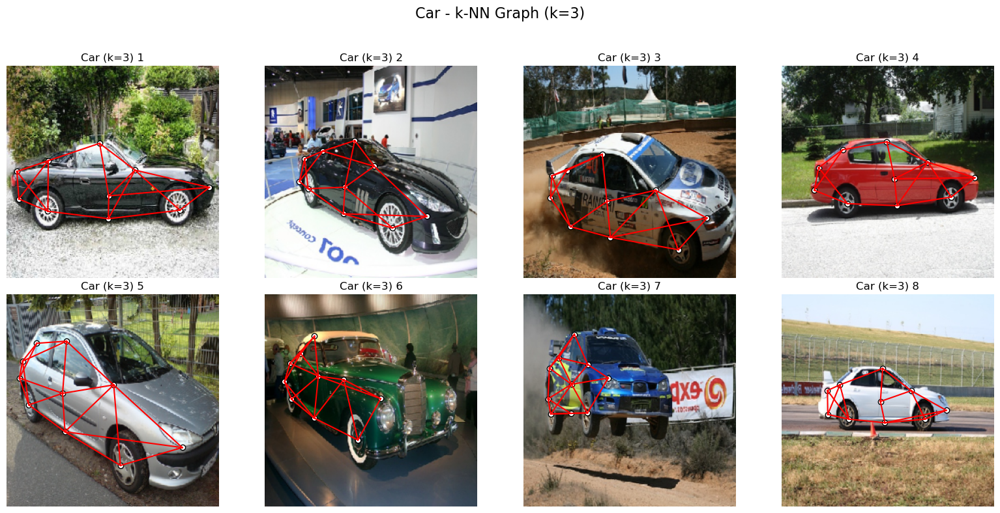

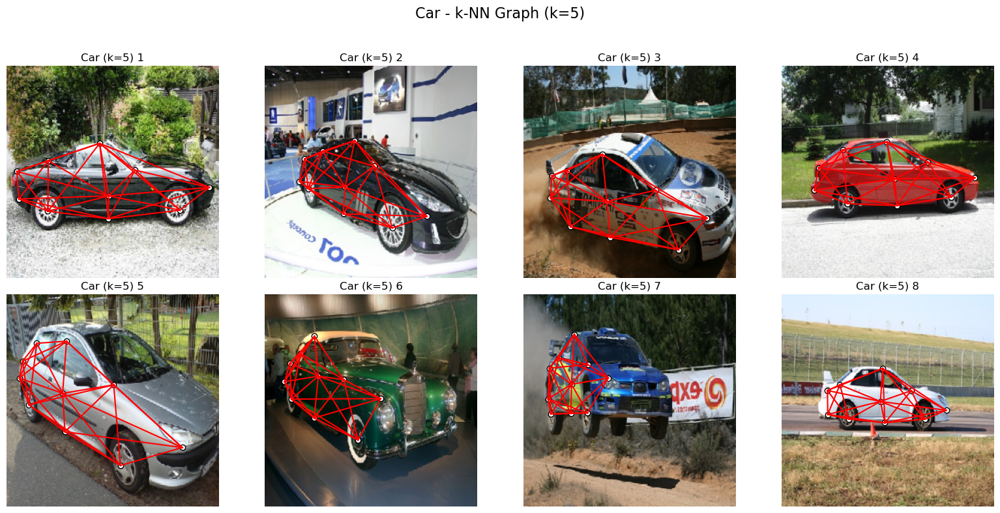

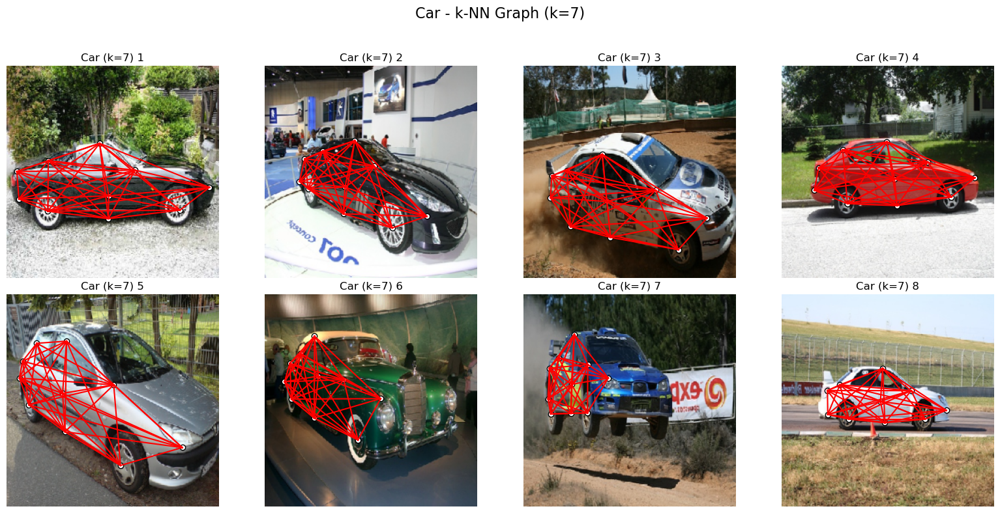

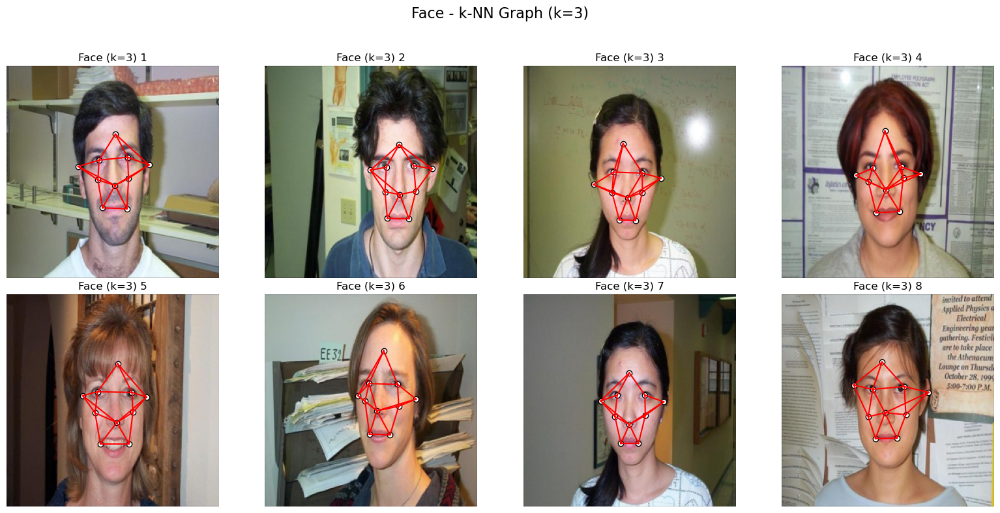

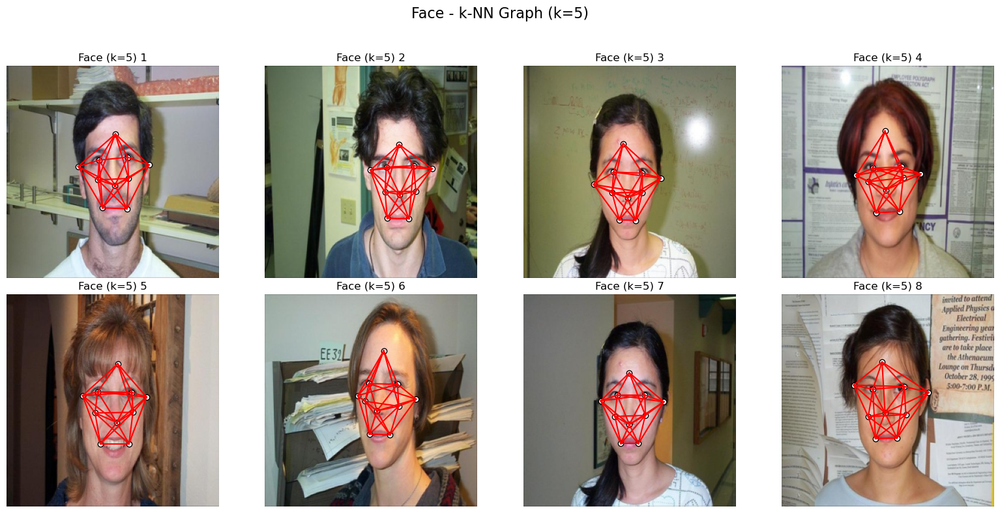

...

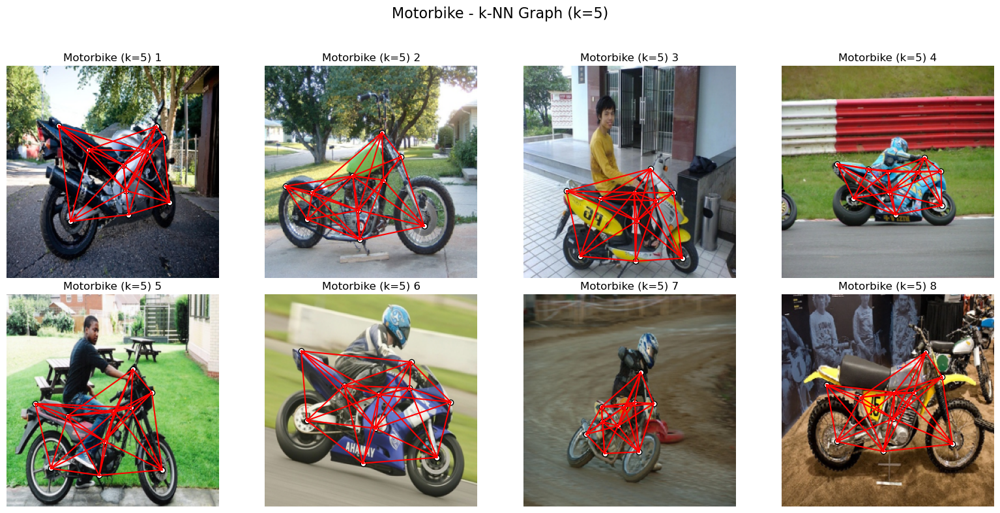

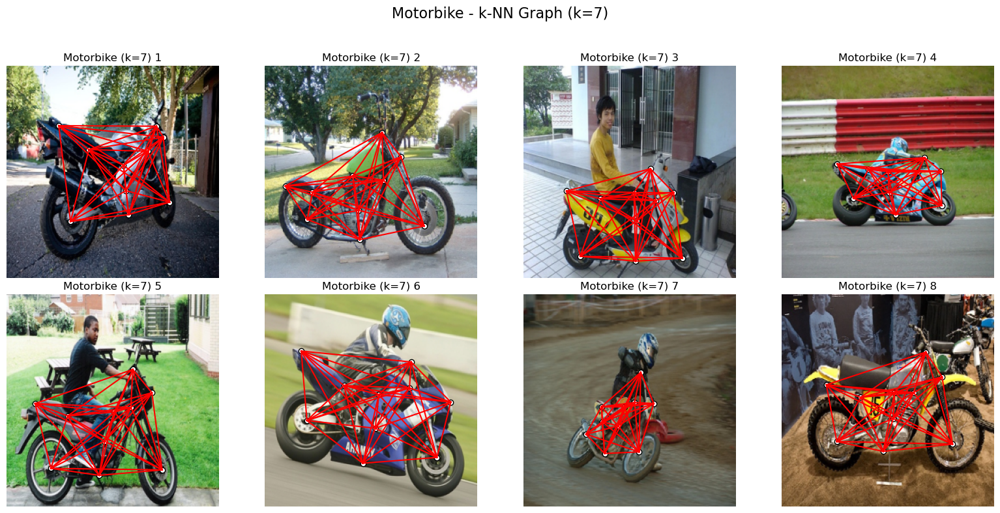

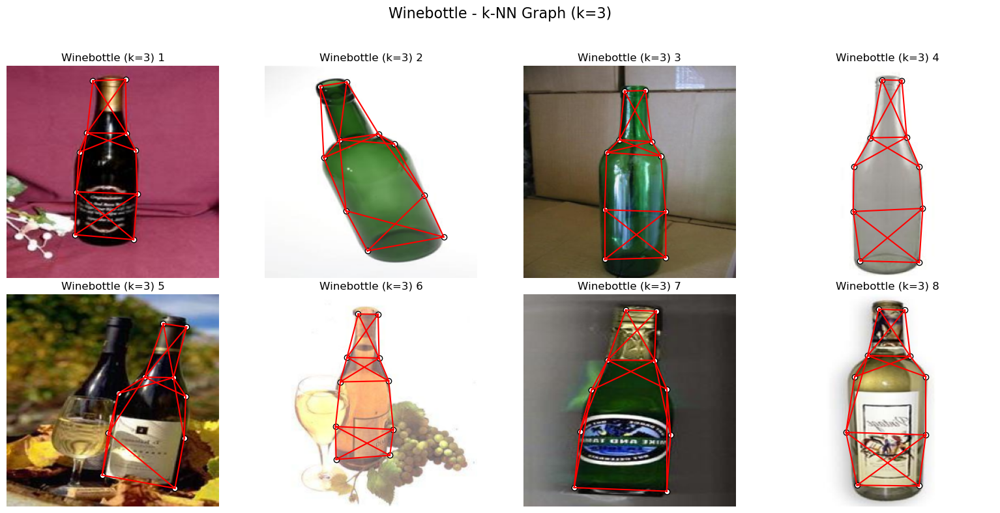

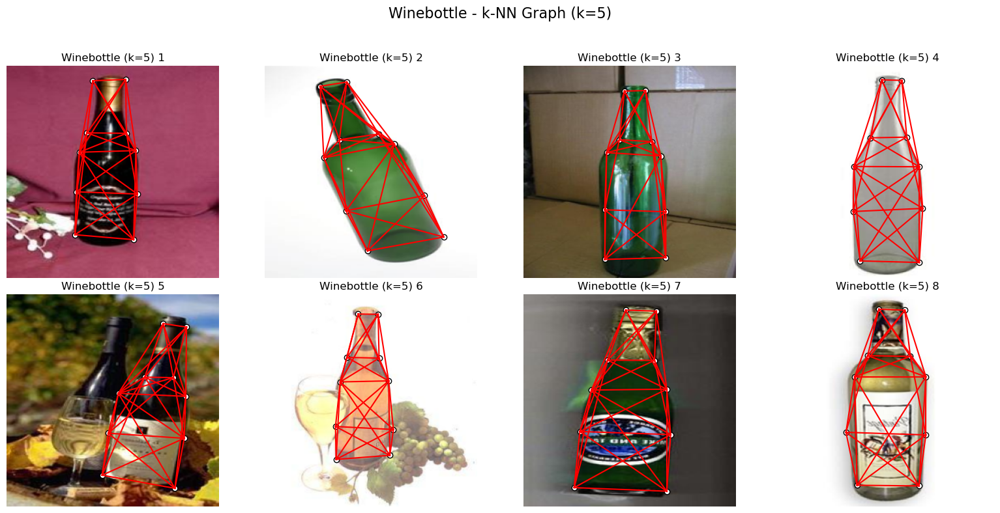

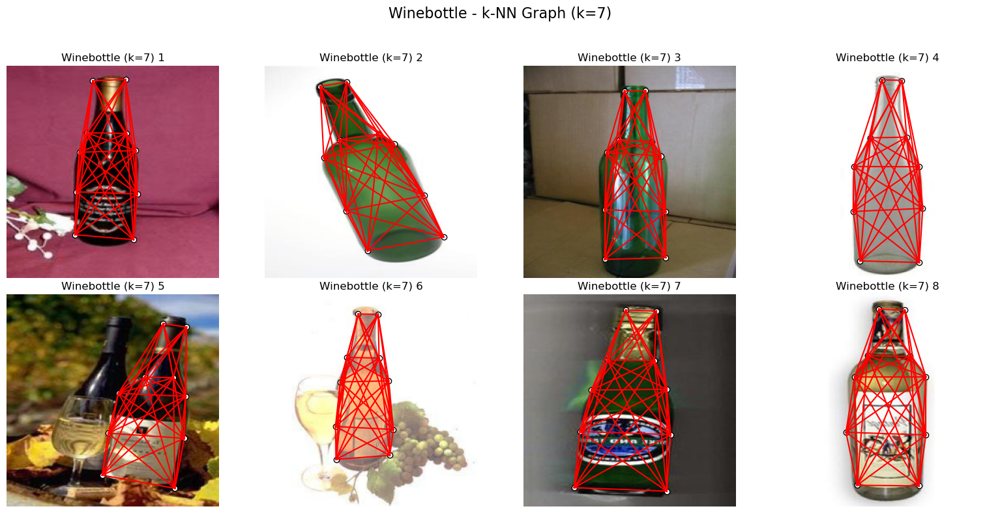

In [ ]:
# Ejercicio 2: k-Nearest Neighbors (k-NN)
# Para cada categoría y para cada valor de k (3, 5, 7), se muestra un grid 2x4.

ks = [3, 5, 7]

for cat in categories:
    key = f"{cat}_df"
    df_cat = dfs.get(key)
    if df_cat is None or df_cat.empty:
        print(f"No se encontró información para la categoría: {cat}")
        continue
    
    # Seleccionar 8 imágenes
    sample_rows = df_cat.sample(8) if len(df_cat) >= 8 else df_cat
    
    for k in ks:
        ncols = 4
        nrows = (len(sample_rows) + ncols - 1) // ncols
        fig, axs = plt.subplots(nrows, ncols, figsize=(16, 8))
        axs = axs.flatten()
        
        for i, (_, row) in enumerate(sample_rows.iterrows()):
            img, kpts = load_img_and_keypoints_from_row(row)
            edges = knn_graph(kpts, k)
            plot_image_with_graph(axs[i], img, kpts, edges, title=f"{cat.capitalize()} (k={k}) {i+1}")
        
        for ax in axs[len(sample_rows):]:
            ax.axis('off')
        
        fig.suptitle(f"{cat.capitalize()} - k-NN Graph (k={k})", fontsize=16)
        plt.tight_layout(rect=[0, 0, 1, 0.95])
        plt.show()